In [14]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import torchvision
from torchvision import transforms

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
import cv2
from PIL import Image

import random
import time

try:
    from torchsummary import summary
except:
    !pip install torch_summary
    from torchsummary import summary
    
import os
import shutil

import warnings
warnings.filterwarnings("ignore")

In [16]:
!git clone https://github.com/Almotasembelah/Age_Gender_Race_Classification.git

Cloning into 'Age_Gender_Race_Classification'...
remote: Enumerating objects: 152, done.
remote: Counting objects: 100% (152/152), done.
remote: Compressing objects: 100% (108/108), done.
remote: Total 152 (delta 36), reused 141 (delta 25), pack-reused 0 (from 0)
Receiving objects: 100% (152/152), 29.60 KiB | 9.87 MiB/s, done.
Resolving deltas: 100% (36/36), done.


In [17]:
import shutil

shutil.move('Age_Gender_Race_Classification/models', 'models')
shutil.move('Age_Gender_Race_Classification/utils', 'utils')
! rm -r Age_Gender_Race_Classification

In [18]:
# import importlib
# import models, utils
# importlib.reload(utils)
# importlib.reload(models)
from utils.manager import *
from models.models import *
from models.cnn_model import *
from utils.data import *

In [19]:
root = '/kaggle/input/fairface/FairFace/'
train_csv = root + 'train_labels.csv'
val_csv = root + 'val_labels.csv'
train_labels = pd.read_csv(train_csv)
val_labels = pd.read_csv(val_csv)

# Loading the Model


In [20]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [21]:
val_transform = transforms.Compose([ 
                                transforms.Resize(224),
                                transforms.ToTensor(),
                               ])

val_dataset = FairFaceDataset(val_labels, transform=val_transform)
val_loader = DataLoader(dataset=val_dataset, batch_size=32, drop_last=True)

In [23]:
torch.cuda.manual_seed(42)
torch.manual_seed(42)
gen_loss_fn_nl = nn.BCEWithLogitsLoss()
mlt_model = EfficientNetB0(1024, Task.AGE, freeze=False)
mlt_model.model.classifier.fc_age = nn.Sequential(
                                            nn.Linear(1280, 1024, bias=False),
                                            nn.BatchNorm1d(1024),
                                            nn.ReLU(inplace=True),
                                            nn.Dropout1d(0.2),
                                            nn.Linear(1024, 512, bias=False),
                                            nn.BatchNorm1d(512),
                                            nn.ReLU(inplace=True),
                                            nn.Dropout1d(0.2),
                                            nn.Linear(512, 17)
                                            )
mlt_mm = ModelManagerV2(mlt_model, None, None)
mlt_mm.set_dataloaders(val_loader)
mlt_mm.set_tasks_names('Gen', 'Age', 'Race')

In [24]:
mlt_mm.load_checkpoint('/kaggle/input/bestv1/pytorch/default/1/best (1)')

# Displaying the Confusion Matrix and Classification Report

Error loading checkpoint: [Errno 2] No such file or directory: 'best'
The current model with his parameters will be used


  0%|          | 0/342 [00:00<?, ?it/s]

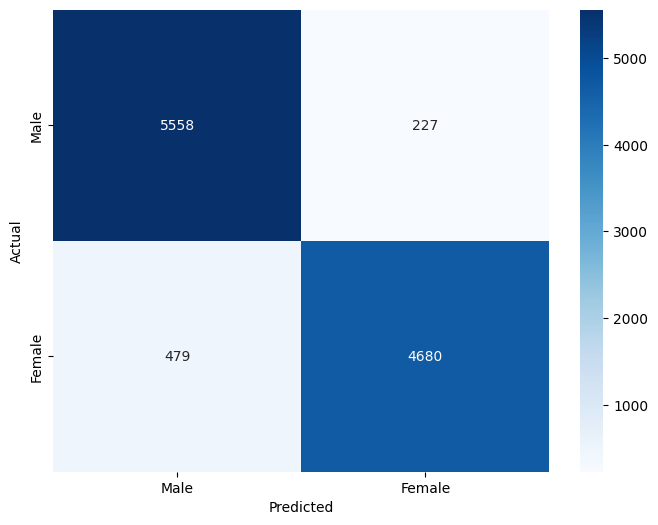

              precision    recall  f1-score   support

        Male       0.92      0.96      0.94      5785
      Female       0.95      0.91      0.93      5159

    accuracy                           0.94     10944
   macro avg       0.94      0.93      0.94     10944
weighted avg       0.94      0.94      0.94     10944



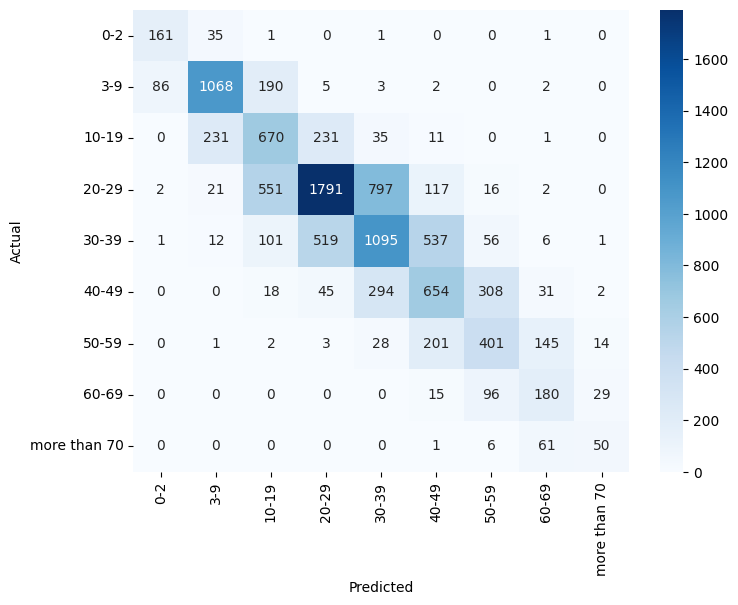

              precision    recall  f1-score   support

         0-2       0.64      0.81      0.72       199
         3-9       0.78      0.79      0.78      1356
       10-19       0.44      0.57      0.49      1179
       20-29       0.69      0.54      0.61      3297
       30-39       0.49      0.47      0.48      2328
       40-49       0.43      0.48      0.45      1352
       50-59       0.45      0.50      0.48       795
       60-69       0.42      0.56      0.48       320
more than 70       0.52      0.42      0.47       118

    accuracy                           0.55     10944
   macro avg       0.54      0.57      0.55     10944
weighted avg       0.57      0.55      0.56     10944



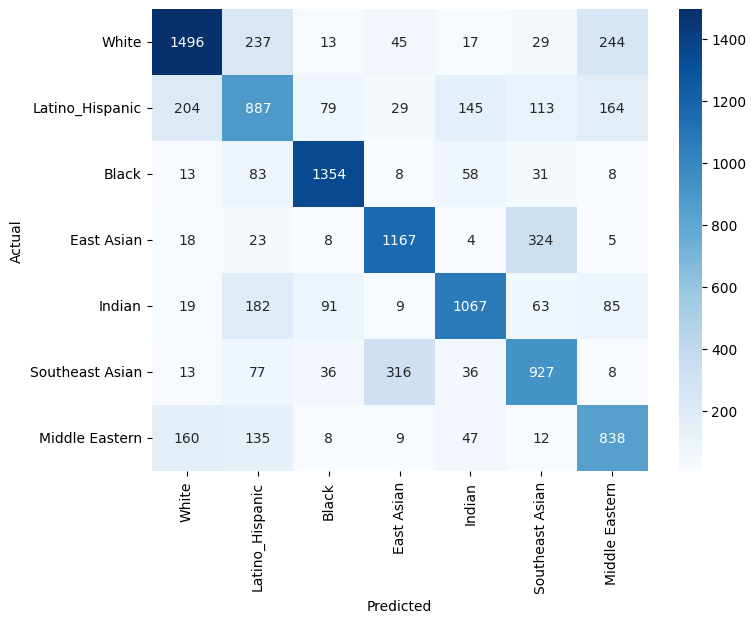

                 precision    recall  f1-score   support

          White       0.78      0.72      0.75      2081
Latino_Hispanic       0.55      0.55      0.55      1621
          Black       0.85      0.87      0.86      1555
     East Asian       0.74      0.75      0.75      1549
         Indian       0.78      0.70      0.74      1516
Southeast Asian       0.62      0.66      0.64      1413
 Middle Eastern       0.62      0.69      0.65      1209

       accuracy                           0.71     10944
      macro avg       0.70      0.71      0.70     10944
   weighted avg       0.71      0.71      0.71     10944



In [26]:
mlt_mm.conf_mat_class_report(val_dataset.classes, report=True)

### **Age Classification Analysis**

1. **General Observations**:
   - For all age classes, most false negatives (FNs) are misclassified within one adjacent age group. This is expected because individuals in adjacent age groups often share similar facial features.
   - For example, the age group **10-19** is frequently misclassified as **3-9** and **20-29**. This is likely because:
     - Individuals aged 10-15 may still exhibit child-like features, similar to those in the **3-9** group.
     - Individuals aged 17-19 may start to exhibit more adult-like features, similar to those in the **20-29** group.

2. **Ethnicity and Age Perception**:
   - Ethnicity can influence age perception. For instance, individuals of Asian descent might appear younger than their actual age, which could lead to misclassifications in younger age groups.


### **Race Classification Analysis**


1. **Black**:
   - **Correct Predictions**: High correct predictions (1354).
   - **Misclassifications**: Mostly confused with **Latino_Hispanic** (83) and **Indian** (58).
   - **Reason**: Similar skin tones and facial features between these groups can lead to confusion. Some individuals of African descent may have skin tones and facial structures that resemble those of Latino/Hispanic or Indian individuals.

2. **East Asian**:
   - **Correct Predictions**: High correct predictions (1167).
   - **Misclassifications**: Mostly confused with **Southeast Asian** (324).
   - **Reason**: East Asians and Southeast Asians share many facial features, such as eye shape and skin tone, making it challenging for the model to distinguish between them.

3. **Indian**:
   - **Correct Predictions**: High correct predictions (1067).
   - **Misclassifications**: Mostly confused with **Latino_Hispanic** (182) and **Black** (91).
   - **Reason**: Similar skin tones and facial features between these groups can lead to confusion. Additionally, the diversity within the Indian population can result in a wide range of features that overlap with other racial groups.

4. **Southeast Asian**:
   - **Correct Predictions**: High correct predictions (927).
   - **Misclassifications**: Mostly confused with **East Asian** (316).
   - **Reason**: As mentioned earlier, the shared facial features between East Asians and Southeast Asians can lead to confusion.

5. **Middle Eastern**:
   - **Correct Predictions**: High correct predictions (838).
   - **Misclassifications**: Mostly confused with **White** (160) and **Latino_Hispanic** (135).
   - **Reason**: Individuals from the Middle East can have a wide range of skin tones and facial features that overlap with those of White and Latino/Hispanic individuals.

# Analyzing the missclassified Images

In this Section, we will see the missclassified Images.

In [27]:
display_fn = create_misclassification_viewer(mlt_model, val_loader, val_dataset.classes)
# Displaying the FNs
viewer_10_9 = display_fn(true_label="10-19", predicted_label="3-9")
viewer_10_20 = display_fn("10-19", "20-29")
viewer_white_black = display_fn("White", "Black")
viewer_black_white = display_fn("Black", 'White')
viewer_indian_latino = display_fn("Indian", 'Latino_Hispanic')
viewer_latino_indian = display_fn('Latino_Hispanic', "Indian")
viewer_mid_eastern_white = display_fn('Middle Eastern', "White")
viewer_east_southeast_asian = display_fn('East Asian','Southeast Asian')

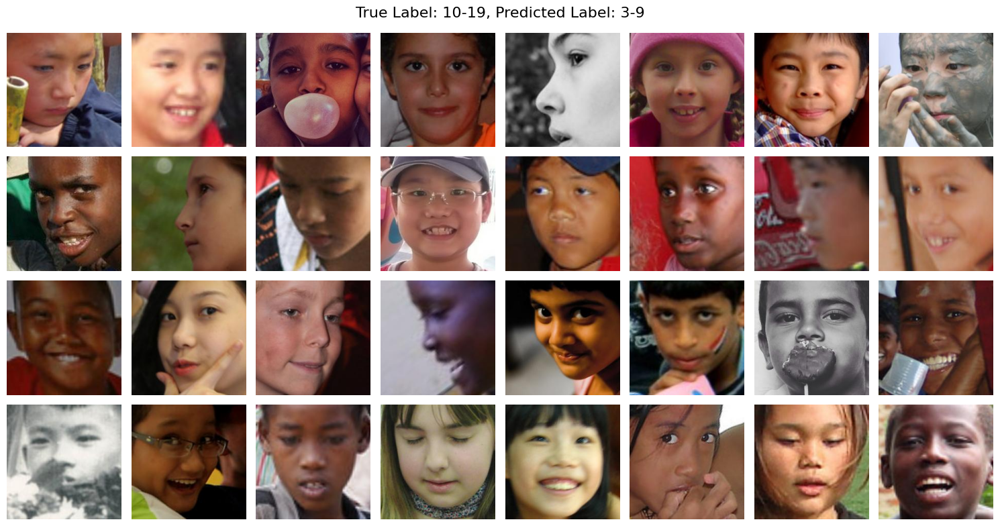

In [28]:
viewer_10_9()

As expected, the individuals aged **10-19** who have been incorrectly classified as belonging to the **3-9** age group often exhibit childlike facial features, making them appear younger. This misclassification is not solely a model limitation; even humans might struggle to accurately determine their ages.

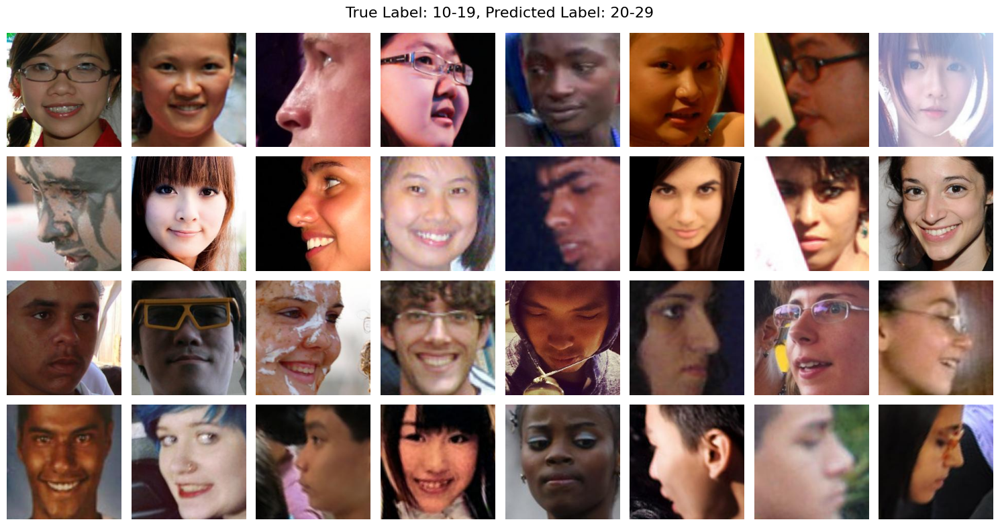

In [29]:
viewer_10_20() #Age Group 10-19 classified as 10-20

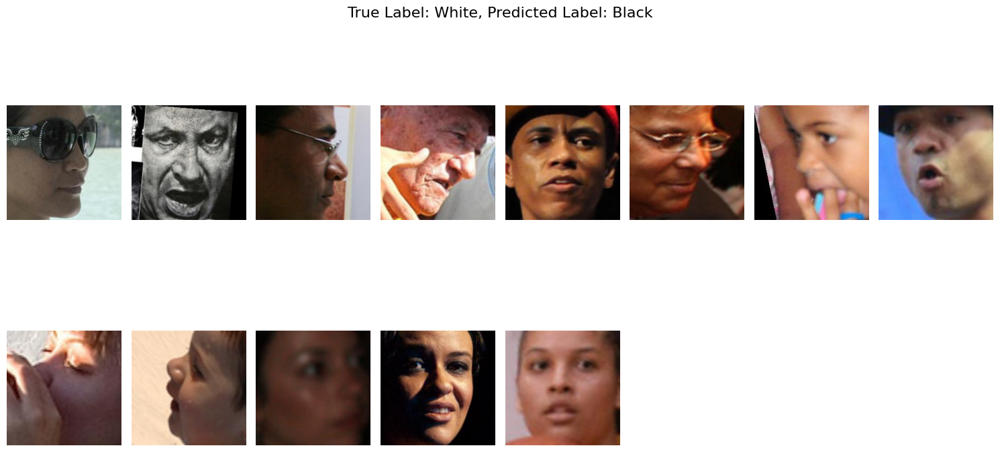

In [30]:
viewer_white_black()

The images above show individuals who have been classified as **Black**, despite actually belonging to the **White** ethnic group. This kind of misclassification suggests potential challenges in the model’s ability to distinguish skin tones, facial features, and contextual elements reliably.

#### Possible Reasons for Misclassification:

1. **Lighting & Shadows**  
   - Poor lighting, shadows, or high contrast can darken skin tones, leading to incorrect classification.  

2. **Pose & Partial Visibility**  
   - Some images contain **side profiles, occlusions (glasses, hands, objects), or low-resolution details**, reducing the model’s ability to extract ethnicity-related features.    

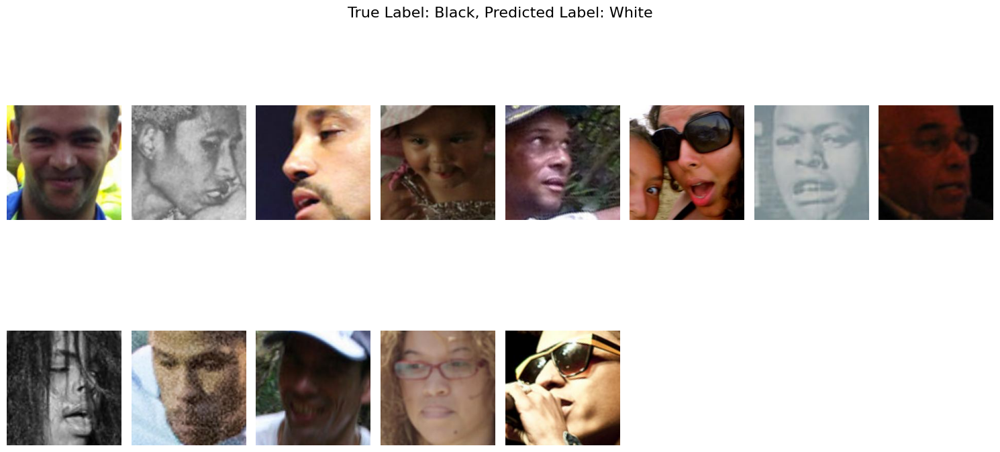

In [31]:
viewer_black_white()

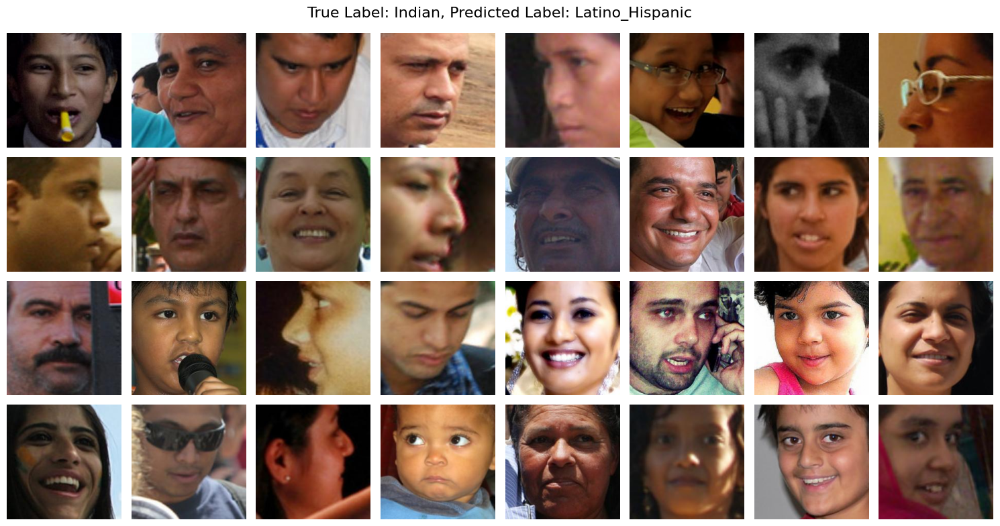

In [32]:
viewer_indian_latino() 

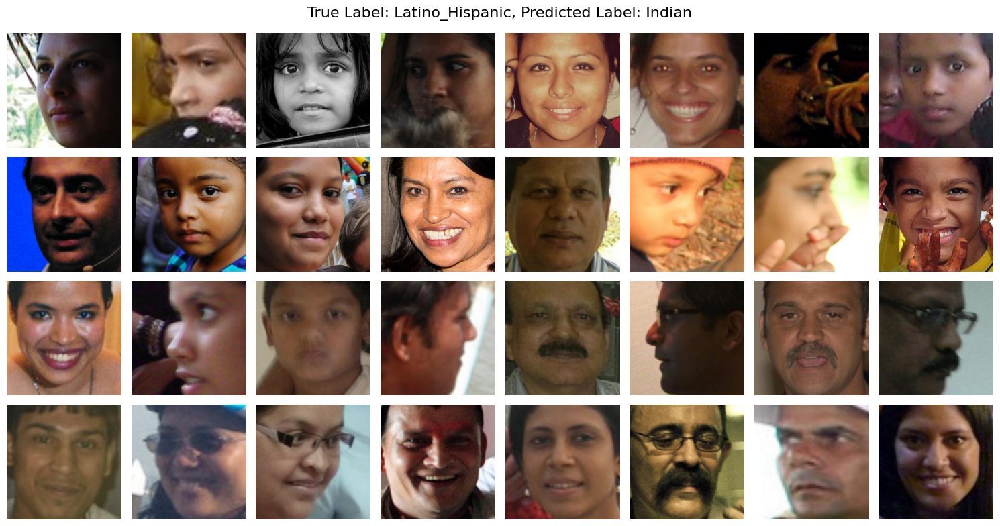

In [33]:
viewer_latino_indian()

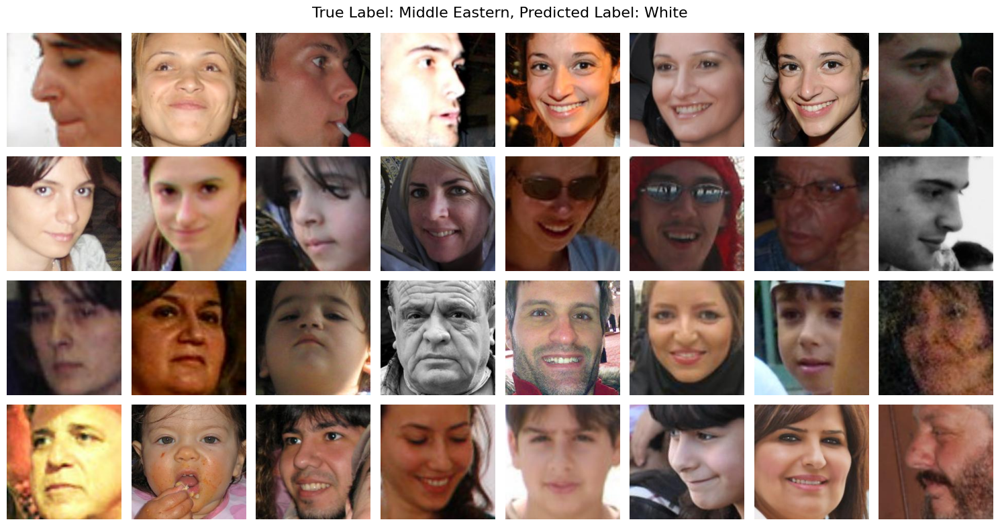

In [34]:
viewer_mid_eastern_white() 

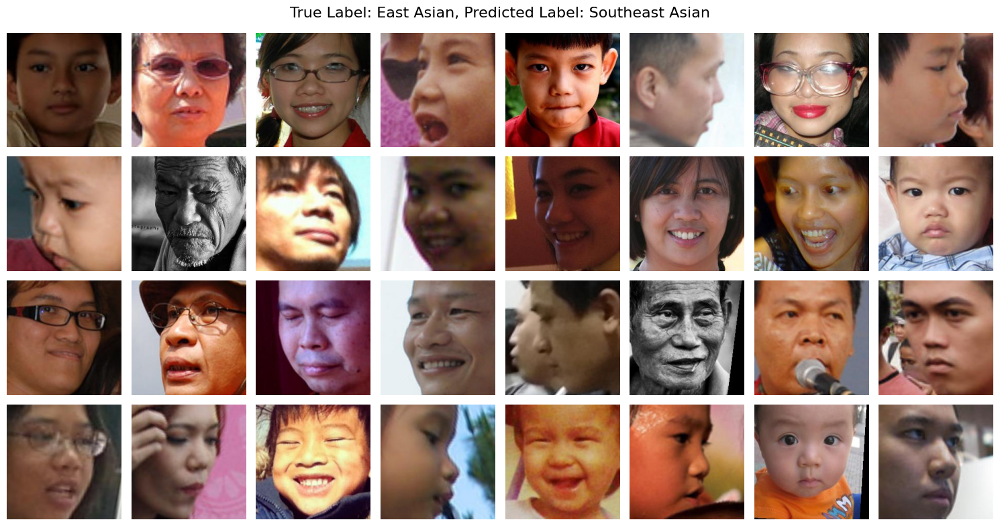

In [35]:
viewer_east_southeast_asian() 

# Displaying Samples with Their Predictions

In [36]:
classify = display_classified_images(mlt_model, val_loader, val_dataset)

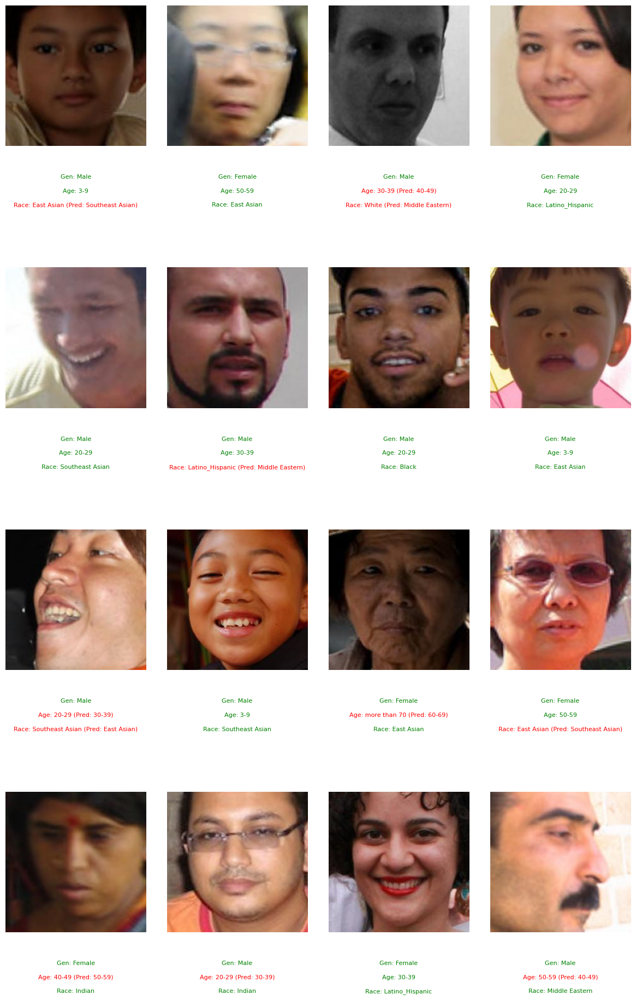

In [37]:
classify() # run it again to change the batch

## Viewing the Predicted Probabilities

Forward pass took 63.76 ms
Class : Female with probability 99.47%
---------------
Class 1: 0-2 with probability 0.02%
Class 2: 3-9 with probability 2.62%
Class 3: 10-19 with probability 37.11%
Class 4: 20-29 with probability 44.39%
Class 5: 30-39 with probability 14.85%
Class 6: 40-49 with probability 0.97%
Class 7: 50-59 with probability 0.03%
Class 8: 60-69 with probability 0.00%
Class 9: more than 70 with probability 0.00%
----------------------
Class 1: White with probability 9.58%
Class 2: Latino_Hispanic with probability 39.57%
Class 3: Black with probability 39.65%
Class 4: East Asian with probability 1.40%
Class 5: Indian with probability 2.61%
Class 6: Southeast Asian with probability 5.47%
Class 7: Middle Eastern with probability 1.72%
Predictions:
gender:  Female age:  20-29 race:  Black
True labels
Gender:  Female Age:  10-19 Race:  Latino_Hispanic


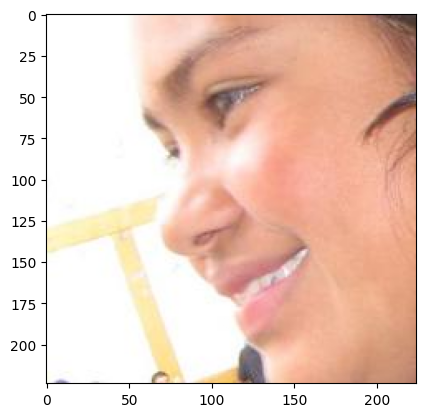

In [38]:
# torch.cuda.empty_cache()
idx = random.choice(range(len(val_dataset)))
img, (gen, age, race) = val_dataset[idx]
printNetResults(mlt_model, img, val_dataset.gender_classes, val_dataset.age_classes, val_dataset.race_classes)

print('True labels')
print('Gender: ', val_dataset.gender_classes[gen.int().item()], 
     'Age: ', val_dataset.age_classes[age],
     'Race: ', val_dataset.race_classes[race])

plt.imshow(img.squeeze(0).permute(1, 2, 0).detach().cpu().numpy())
plt.show()

# Grad-CAM

Forward pass took 15.20 ms
Class : Female with probability 90.30%
---------------
Class 1: 0-2 with probability 0.00%
Class 2: 3-9 with probability 5.62%
Class 3: 10-19 with probability 48.40%
Class 4: 20-29 with probability 26.54%
Class 5: 30-39 with probability 14.89%
Class 6: 40-49 with probability 3.98%
Class 7: 50-59 with probability 0.55%
Class 8: 60-69 with probability 0.02%
Class 9: more than 70 with probability 0.00%
----------------------
Class 1: White with probability 0.02%
Class 2: Latino_Hispanic with probability 0.47%
Class 3: Black with probability 90.74%
Class 4: East Asian with probability 0.44%
Class 5: Indian with probability 5.59%
Class 6: Southeast Asian with probability 2.71%
Class 7: Middle Eastern with probability 0.03%
Predictions:
gender:  Female age:  10-19 race:  Black
True labels
Gender:  Female Age:  30-39 Race:  Black


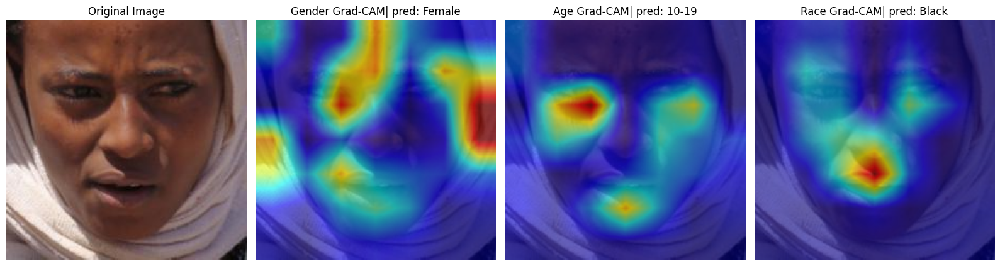

In [39]:
idx = random.choice(range(len(val_dataset)))
img, (gen, age, race) = val_dataset[idx]
printNetResults(mlt_model, img, val_dataset.gender_classes, val_dataset.age_classes, val_dataset.race_classes)
print('True labels')
print('Gender: ', val_dataset.gender_classes[gen.int().item()], 
     'Age: ', val_dataset.age_classes[age],
     'Race: ', val_dataset.race_classes[race])

heatmap = display_image_and_gradcam(mlt_model, img, target_layer='features.8', val_dataset=val_dataset) 

In [40]:
def load_imgs(gender, age, race, num=4):
    file = val_labels[(val_labels['gender'] == gender) & (val_labels['age'] == age) & (val_labels['race'] == race) ].file
    img_list = []
    for i in range(num):
        idx = random.choice(range(len(file)))
        img = Image.open(root + file.iloc[idx])
        img = val_transform(img)
        img_list.append(img)
    return torch.stack(img_list)

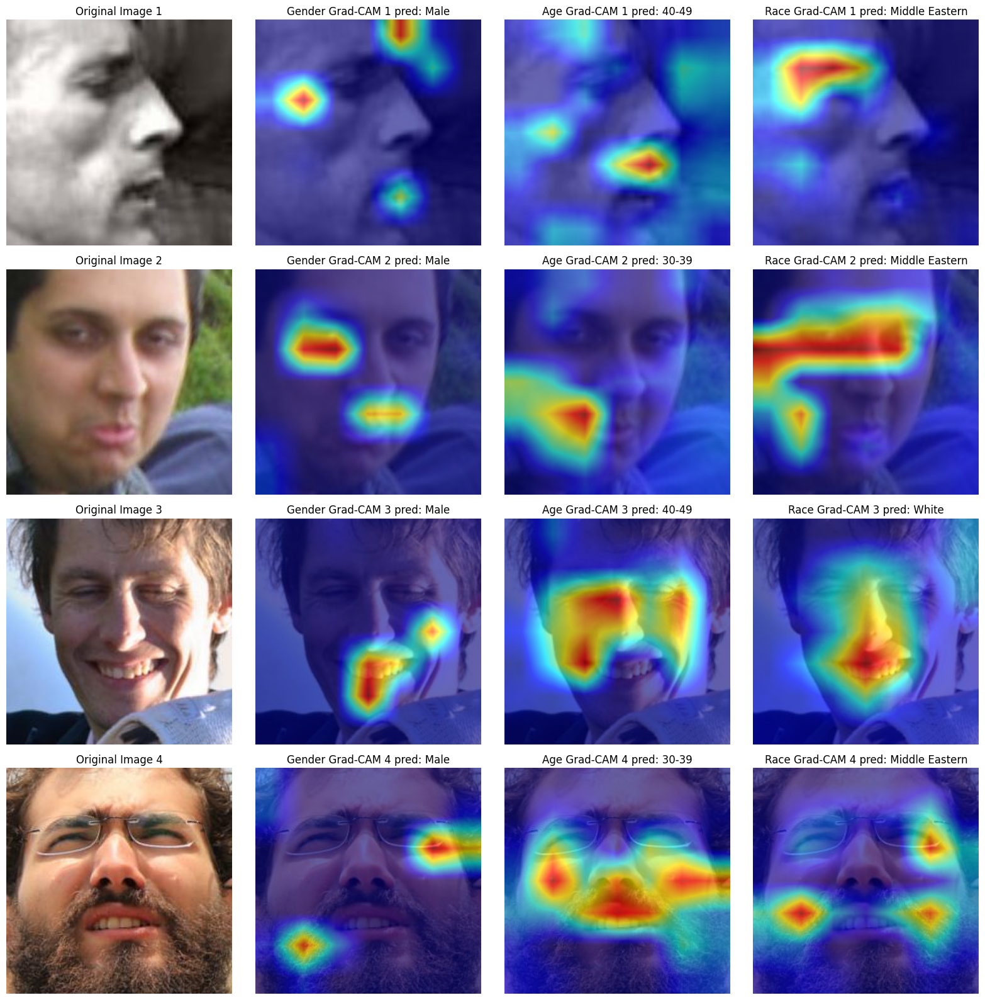

In [41]:
# display grad cam for specific classes (Male, 30-39, White)
imgs = load_imgs('Male', '30-39', 'White')
heatmap = display_images_and_gradcam_v1(mlt_model, imgs, 'features.8', val_dataset) 

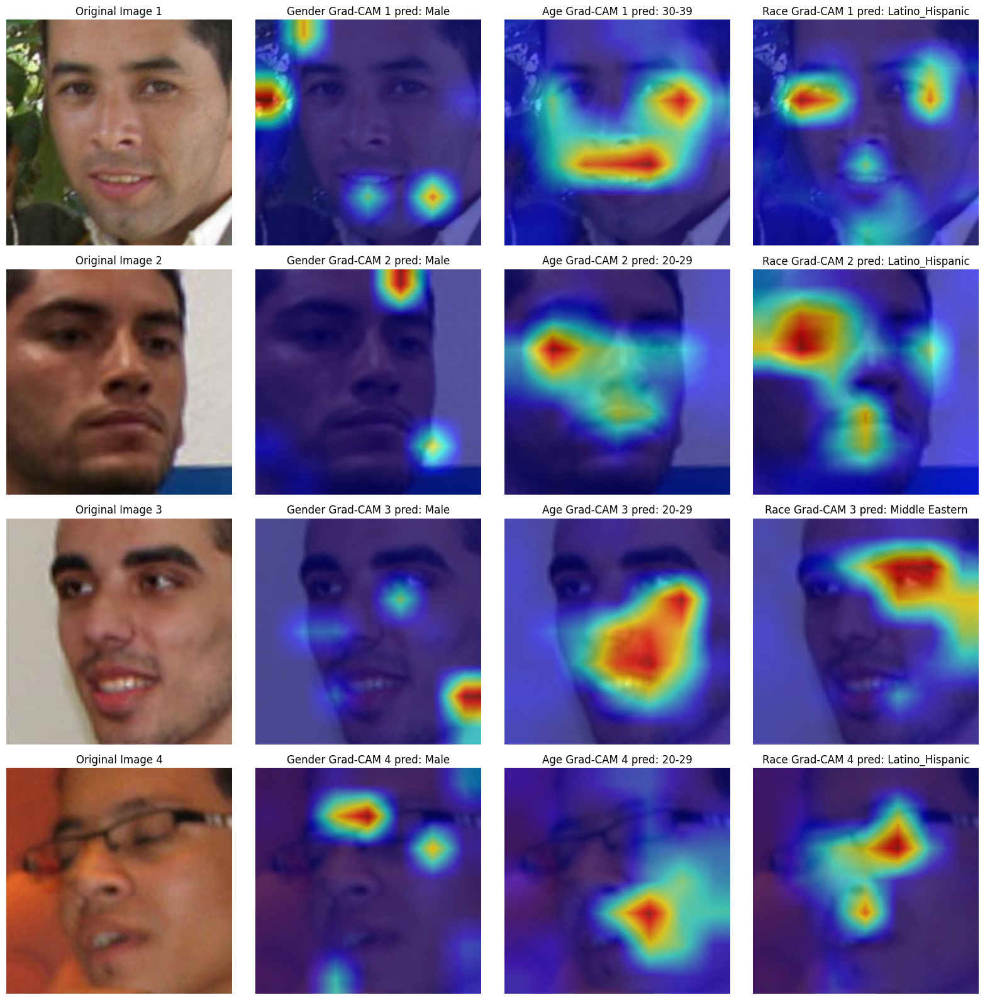

In [42]:
imgs = load_imgs('Male', '20-29', 'Latino_Hispanic')
heatmap = display_images_and_gradcam_v1(mlt_model, imgs, 'features.8', val_dataset) 

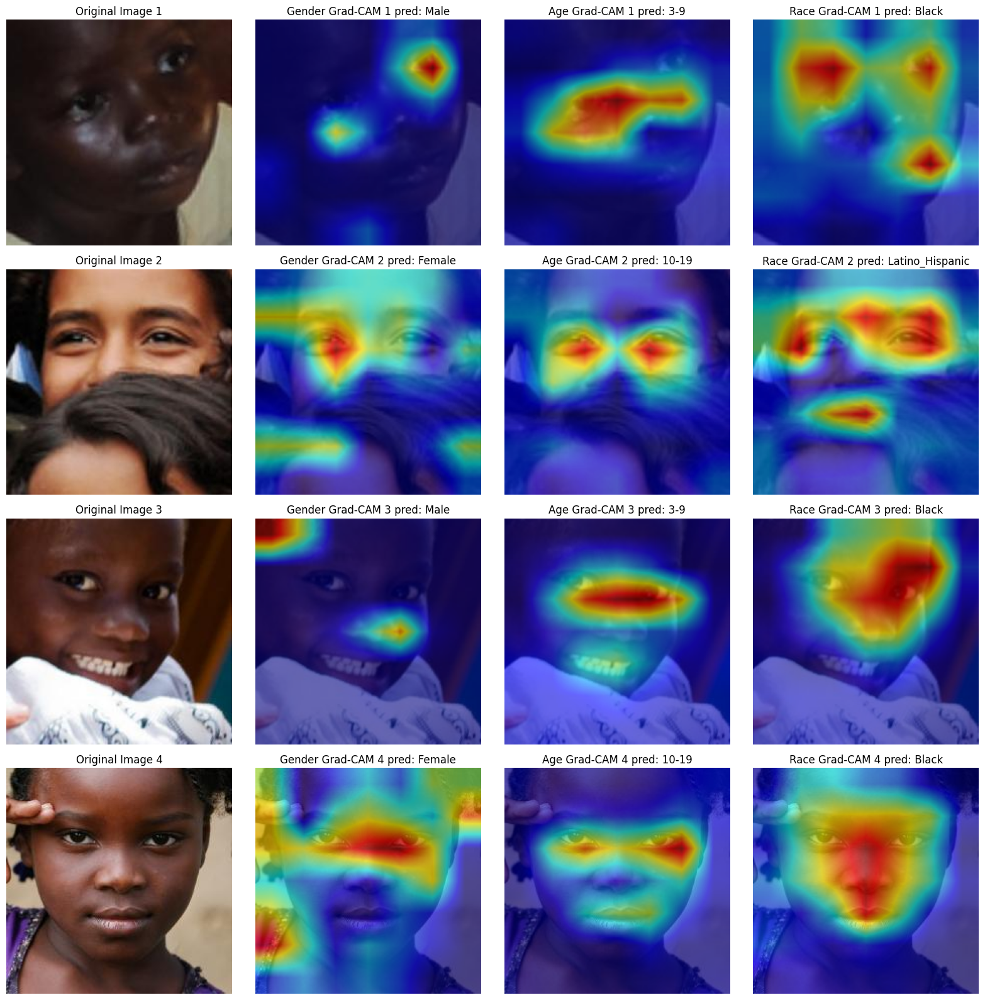

In [43]:
imgs = load_imgs('Female', '3-9', 'Black')
heatmap = display_images_and_gradcam_v1(mlt_model, imgs, 'features.8', val_dataset) 